In [ ]:
import numpy as np
import pandas as pd
import scipy.stats as scs 
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from statsmodels.formula.api import ols

# Det givna datasettet. https://www.kaggle.com/datasets/shivam2503/diamonds
diamonds = pd.read_csv('diamonds.csv')

# Plotinställningar
sns.set(rc = {'figure.figsize':(10, 5)})
plt.style.use('dark_background')

#### Inlämningsuppgift - Statistiska Metoder AI23
---

# Diamonds

---

I denna rapport kommer jag främst att studera diamanternas volym och dimensioner för att sedan analysera korrelation och prediktion med diamanternas pris och rankningar.

In [ ]:
# Tar bort de diamanter som har 0mm i x, y eller z och där med ingen volym.
diamonds = diamonds[diamonds['x'] > 0]
diamonds = diamonds[diamonds['y'] > 0]
diamonds = diamonds[diamonds['z'] > 0]

# Och tar bort de värsta outliers som det inte heller verkar som att det finns någon förklaring till i dokumentationen.
diamonds = diamonds[diamonds['x'] < 12]
diamonds = diamonds[diamonds['y'] < 12]
diamonds = diamonds[diamonds['z'] < 12]

# Lägger till en kolumn för volym.
diamonds['volume'] = diamonds['x'] * diamonds['y'] * diamonds['z']

# Skapar en kolumn för att översätta 'cut', 'color' och 'clarity' till ett poängsystem då de är ordinal data och därmed kan rangordnas. (Även fast poängen i detta fall kanske inte blir helt likvärdiga.)
diamonds['cut_points'] = diamonds['cut']
diamonds['cut_points'].replace({'Fair': 1, 'Good': 2, 'Very Good': 3, 'Premium': 4, 'Ideal': 5}, inplace=True)

diamonds['color_points'] = diamonds['color']
diamonds['color_points'].replace({'J': 1, 'I': 2, 'H': 3, 'G': 4, 'F': 5, 'E': 6, 'D': 7}, inplace=True)

diamonds['clarity_points'] = diamonds['clarity']
diamonds['clarity_points'].replace({'I1': 1, 'SI2': 2, 'SI1': 3, 'VS2': 4, 'VS1': 5, 'VVS2': 6, 'VVS1': 7, 'IF': 8}, inplace=True)

diamonds['total_points'] = diamonds['cut_points'] + diamonds['color_points'] + diamonds['clarity_points']

# Funktionen .replace() verkar vara på väg att avvecklas, men gör jobbet för nu.

Nedan ges en generell överblick av datans olika värden, samt de första fem datapunkterna för att ge en bild av hur datan ser ut.

In [3]:
display(diamonds.describe())
display(diamonds.head())

,carat,depth,table,price,x,y,z,volume,cut_points,color_points,clarity_points,total_points
count,53917.000000,53917.000000,53917.000000,53917.000000,53917.000000,53917.000000,53917.000000,53917.000000,53917.000000,53917.000000,53917.000000,53917.000000
mean,0.797687,61.749565,57.456939,3930.910474,5.731605,5.733428,3.539409,129.802460,3.904223,4.405939,4.051505,12.361667
std,0.473777,1.432318,2.234069,3987.215003,1.119402,1.111272,0.691620,76.450353,1.116593,1.701281,1.647017,2.735467
min,0.200000,43.000000,43.000000,326.000000,3.730000,3.680000,1.070000,31.707984,1.000000,1.000000,1.000000,3.000000
25%,0.400000,61.000000,56.000000,949.000000,4.710000,4.720000,2.910000,65.188530,3.000000,3.000000,3.000000,10.000000
50%,0.700000,61.800000,57.000000,2401.000000,5.700000,5.710000,3.530000,114.840180,4.000000,4.000000,4.000000,12.000000
75%,1.040000,62.500000,59.000000,5323.000000,6.540000,6.540000,4.040000,170.844704,5.000000,6.000000,5.000000,14.000000
max,5.010000,79.000000,95.000000,18823.000000,10.740000,10.540000,6.980000,790.133208,5.000000,7.000000,8.000000,20.000000


,carat,cut,color,clarity,depth,table,price,x,y,z,volume,cut_points,color_points,clarity_points,total_points
0,0.23,Ideal,E,SI2,61.5,55.0,326,3.95,3.98,2.43,38.202030,5,6,2,13
1,0.21,Premium,E,SI1,59.8,61.0,326,3.89,3.84,2.31,34.505856,4,6,3,13
2,0.23,Good,E,VS1,56.9,65.0,327,4.05,4.07,2.31,38.076885,2,6,5,13
3,0.29,Premium,I,VS2,62.4,58.0,334,4.20,4.23,2.63,46.724580,4,2,4,10
4,0.31,Good,J,SI2,63.3,58.0,335,4.34,4.35,2.75,51.917250,2,1,2,5


### Fokus: Diamanternas volym

Här finner vi att:

- Den genomsnittliga diamanten har volymen $129.8mm^3$ (Väntevärdet = $\mu$ = 129.80)
- Standardavvikelsen = $\sigma$ = 76.45
- medianen är 114.84

In [4]:
display(diamonds['volume'].describe())

count    53917.000000
mean       129.802460
std         76.450353
min         31.707984
25%         65.188530
50%        114.840180
75%        170.844704
max        790.133208
Name: volume, dtype: float64

Vi finner även att snedheten är åt höger då snedhetsvärdet är positivt.

In [5]:
volume = diamonds['volume']

print(f"Diamantvolymen har en snedhet på {volume.skew():.4f}, (alltså sned åt {"höger" if volume.skew() > 0 else "vänster"}).")

Diamantvolymen har en snedhet på 1.1123, (alltså sned åt höger).


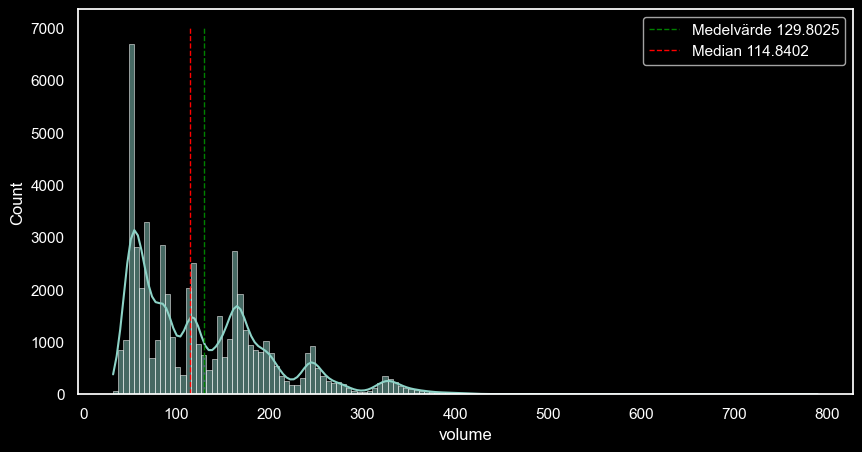

In [22]:
fig, ax = plt.subplots()
sns.histplot(volume, kde=True, ax=ax).grid(False)

plt.plot([volume.mean(), volume.mean()], [0, 7000], color='green', linestyle='--', linewidth=1, label=f'Medelvärde {volume.mean():.4f}')
plt.plot([volume.median(), volume.median()], [0, 7000], color='red', linestyle='--', linewidth=1, label=f'Median {volume.median():.4f}')

legend = plt.legend(loc='upper right')
plt.show()

### Korrelation och kovarians

Nedan testar jag hur de numeriska värdena i vår data korrelerar med varandra.

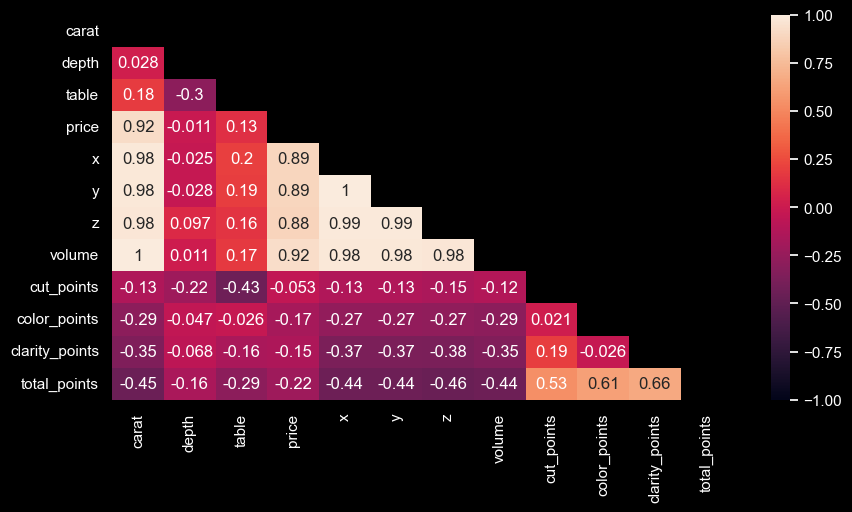

In [13]:
corr = diamonds[['carat', 'depth', 'table', 'price', 'x', 'y', 'z', 'volume', 'cut_points', 'color_points', 'clarity_points', 'total_points']].corr()
mask = np.triu(np.ones_like(corr, dtype=bool))

plt.style.use('dark_background')
sns.heatmap(corr, mask=mask, annot=True, vmin=-1, vmax=1).grid(False)

Till föga förvåning ser vi att diamanternas vikt (carat) och dess dimensioner/volym korrelerar högt med varandra.

### Konfidensintervall

Jag vill konstruera ett 95% konfidensintervall för hur många diamanter av den bästa slipningen som också är den klaraste.

In [26]:
from scipy.stats import norm

ideal = diamonds[diamonds['cut'] == 'Ideal']
IF = ideal[ideal['clarity'] == 'IF']

prop_p = len(IF) / len(ideal)
n = len(ideal)
a = 0.05

In [27]:
n*prop_p, n*(1-prop_p)

(1212.0, 20335.0)

In [29]:
z_crit = scs.norm.ppf(1-a/2)
sem = np.sqrt(prop_p*(1-prop_p)/(n-1))

upper = prop_p + z_crit*sem
lower = prop_p - z_crit*sem

print(f"Konfidensintervallet för andelen IF-diamanter i Ideal-kategorin är {lower:.4f} - {upper:.4f}.")

Konfidensintervallet för andelen IF-diamanter i Ideal-kategorin är 0.0532 - 0.0593.


In [19]:
fig = px.scatter(diamonds,
        x='volume',
        y='price',
        color='total_points',
        log_x=True,
        trendline='ols',
        title='Price vs Volume',
        labels={'volume':'Volume', 
                'price':'Price (USD)', 
                'clarity':'Clarity',
                'cut':'Cut',
                'color':'Color',
                'carat':'Carat',
                'depth':'Depth',},
        template='plotly_dark',
        hover_data=['carat', 
                'cut', 
                'color', 
                'depth', 
                'table', 
                'x', 'y', 'z',
                'cut_points',
                'color_points',
                'clarity_points',
                'total_points',],
        marginal_x='histogram',
        marginal_y='violin',
        )

fig.update_layout(autosize=False, width=1500, height=800, legend=dict(yanchor="top", y=0.99, xanchor="left", x=0.80))